In [2]:
import nibabel as nib
import numpy as np
import plotly.graph_objects as go
import time
from google.cloud import storage

client = storage.Client()

bucket_name = 'marketplace-p115jwl6'
segmentation_paths = [
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/adrenal_gland_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/adrenal_gland_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/aorta.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/autochthon_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/autochthon_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/brain.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/clavicula_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/clavicula_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/colon.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/duodenum.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/esophagus.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/face.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/femur_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/femur_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/gallbladder.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/gluteus_maximus_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/gluteus_maximus_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/gluteus_medius_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/gluteus_medius_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/gluteus_minimus_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/gluteus_minimus_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/heart_atrium_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/heart_atrium_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/heart_myocardium.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/heart_ventricle_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/heart_ventricle_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/hip_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/hip_right.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/humerus_left.nii.gz',
    'TotalSegmentator/98/artifactFiles/Totalsegmentator_dataset/s0000/segmentations/humerus_right.nii.gz',
    ]

def load_nifti_files(paths):
    bucket = client.bucket(bucket_name)
    data = []
    
    for path in paths:
        blob = bucket.blob(path)
        local_filename = path.split('/')[-1]
        blob.download_to_filename(local_filename)
        
        img = nib.load(local_filename)
        data.append(img.get_fdata())
        
    return data

start_time = time.time()
segmentation_data = load_nifti_files(segmentation_paths)
end_time = time.time()

total_time = end_time - start_time
print(f"Total time taken for downloading and loading segmentations: {total_time:.2f} seconds")


Total time taken for downloading and loading segmentations: 12.75 seconds


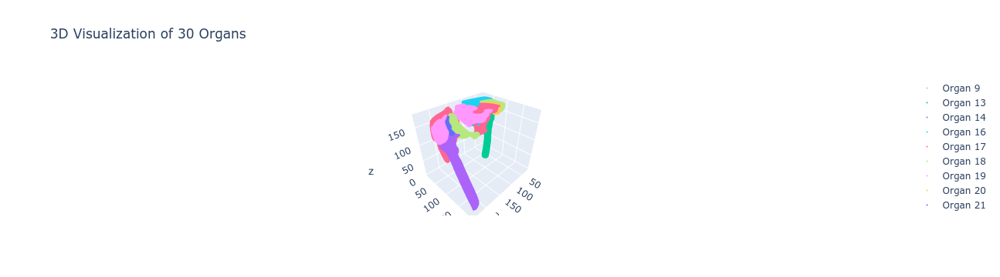

Total time taken for visualization: 2.49 seconds


In [4]:
def visualize_segmentations_3d(data_list):
    fig = go.Figure()
    
    for i, data in enumerate(data_list):
        x, y, z = np.where(data > 0) 
        fig.add_trace(go.Scatter3d(x=x, y=y, z=z, mode='markers', marker=dict(size=1), name=f"Organ {i+1}"))

    fig.update_layout(scene=dict(aspectmode='data'), title='3D Visualization of 30 Organs')
    fig.show()

start_time_visualization = time.time()
visualize_segmentations_3d(segmentation_data)
end_time_visualization = time.time()

total_time_visualization = end_time_visualization - start_time_visualization
print(f"Total time taken for visualization: {total_time_visualization:.2f} seconds")